In [1]:
import numpy as np
import matplotlib.pyplot as plt
from scipy import linalg

# 1.a - Rotina para gerar pacote de ondas gaussianas

Pacote de ondas gaussianas em 2D será gerado por:

$$\psi(x,y,k_0,\sigma)=e^{ik_0x} e^{ik_0y}  e^{-\frac{(x-x_0)^2 + (y-y_0)^2}{2 \sigma^2}}$$


Onde:
$$
\begin{cases}
k_0=Momento linear\\
\sigma^2=variância\\
\end{cases} 
$$

In [2]:
def pacote_onda(x,y,k_0,theta,x_0,y_0,sig):
    k_x = k_0*np.cos(theta*np.pi/180)
    k_y = k_0*np.sin(theta*np.pi/180)
    
    term_1 = k_x*x*1j
    te = k_y*y*1j
    term_2 = ((x-x_0)**2 + (y-y_0)**2)
    return np.exp(-term_2/(2*sig**2))*np.exp(term_1+te)

In [ ]:
x = np.linspace(-10,10,500)
y = np.linspace(-10,10,500)
X,Y = np.meshgrid(x,y)
final = pacote_onda(X,Y,15*np.pi,0,-7,0,0.8)

plt.figure(figsize=(8,8))
plt.title('Wave_Pack')
ot = plt.imshow(abs(final**2),cmap='turbo')
plt.colorbar()
plt.show()

/var/folders/8k/t_r4nndd2ll03bmm2zsmmrpc0000gn/T/ipykernel_2774/1355887943.py:5: MatplotlibDeprecationWarning: Starting from Matplotlib 3.6, colorbar() will steal space from the mappable's axes, rather than from the current axes, to place the colorbar.  To silence this warning, explicitly pass the 'ax' argument to colorbar().
  plt.colorbar(ot)


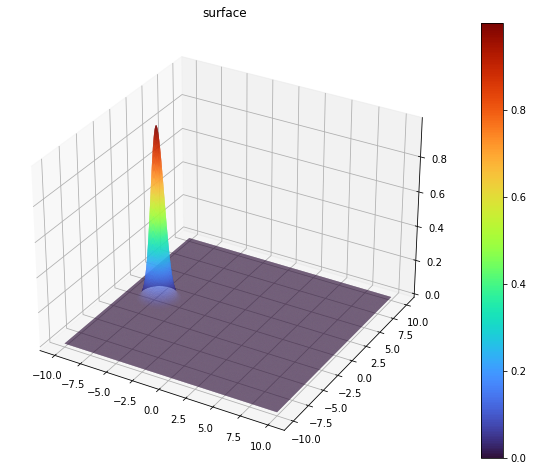

In [4]:
fig = plt.figure(figsize=(14,8))
ax = plt.axes(projection='3d')
ax.plot_surface(X, Y, abs(final**2), rstride=1, cstride=1,
                cmap='turbo', edgecolor='none')
plt.colorbar(ot)
ax.set_title('surface');

# 1.b - Rotina para obter o potencial de n fendas com altura váriavel

Na nossa simulação as barreiras terão potêncial 'infinito', ou seja, as ondas que se chocam com as barreiras são refletidas. Para isso, na nossa simulação a partir do index $i_{bar}$ onde existe a barreira na nossa grid vamos forçar que a função de onda seja nula $\psi [i_{bar}] = 0$.

Para este efeito, construimos construimos uma grid de zeros e as barreiras=1, possíbilitando acessar facilmente estes indexes mais a frente. 

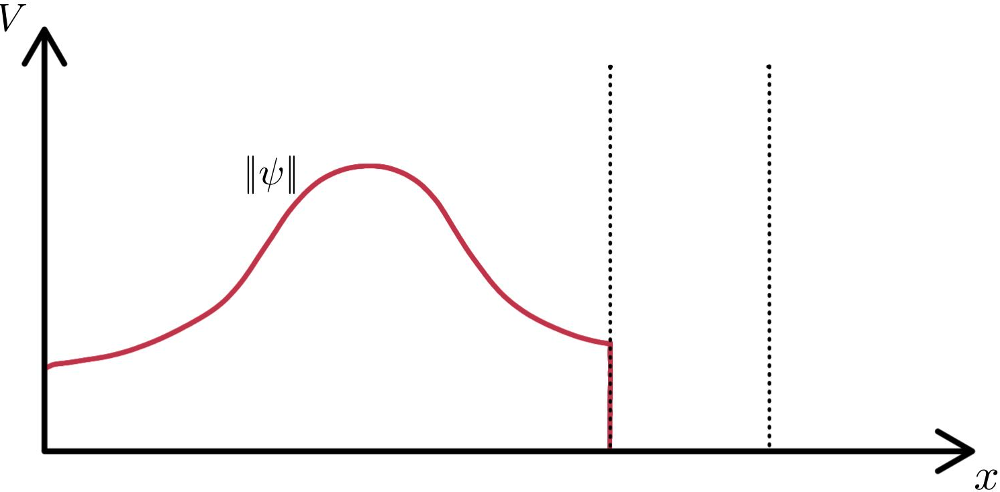

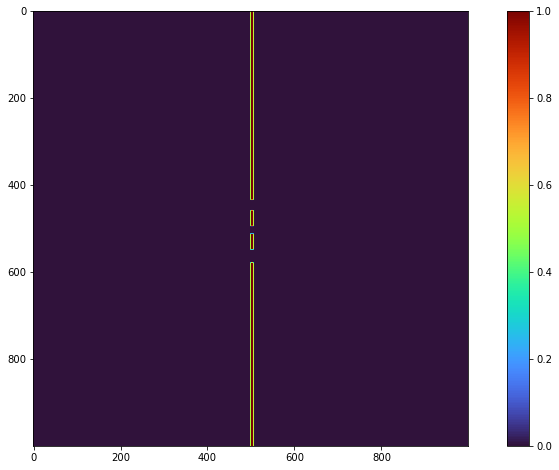

In [5]:
def barriers(N,n,a=1):
    '''
    N: Número de pontos do lado do grid (grid quadrado)
    n: Número de barreiras
    a: Altura barreiras
    '''

    #N = 41 # number of points xx
    grid = np.zeros((N,N))
    center_g = N//2
    x    = np.linspace(-10, 10, N)    # nodos da grelha no espaço
    dx   = x[1] - x[0] 

    cons = (2*int(N/300))
    if n==1:
        grid[center_g-2*cons:center_g+3*cons ,center_g:center_g+a*cons+1] = 1
        
        grid[0:center_g-6*cons,center_g:center_g+(a*cons+1)] = 1
        grid[center_g+8*cons:,center_g:center_g+(a*cons+1)] = 1
        
        return grid
        
    
    
    n_ = n//2 # number of barriers for each side
    for i in range(n_):
        if i==0:
            grid[center_g-7*cons*(i+1):center_g-1*cons*(i+1),center_g:center_g+(a*cons+1)] = 1
            grid[center_g+2*cons*(i+1):center_g+8*cons*(i+1),center_g:center_g+(a*cons+1)] = 1
            
            left_bar = center_g-7*cons*(i+1)
            right_bar = center_g+8*cons*(i+1)
        else:
            if center_g-(7-10*i)*cons >=11: # So that we stay inside the grid
                grid[center_g-(7-10*i)*cons:center_g-(1-11*i)*cons,center_g:center_g+(a*cons+1)] = 1
                grid[center_g+(2+10*i)*cons:center_g+(8+10*i)*cons,center_g:center_g+(a*cons+1)] = 1
                left_bar = center_g-(7-10*i)*cons
                right_bar = center_g+(8+10*i)*cons
            else:
                print('The number of barriers exceeds the grid size')
                break

                
    grid[0:left_bar-4*cons,center_g:center_g+(a*cons+1)] = 1
    grid[right_bar+5*cons:,center_g:center_g+(a*cons+1)] = 1
                
    return grid
    
grid = barriers(1000,2)
plt.figure(figsize=(14,8))
plt.imshow(grid,cmap='turbo')

plt.colorbar()
plt.show()



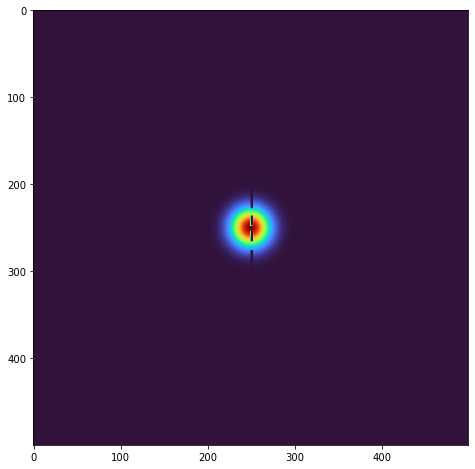

In [6]:
    
psi = pacote_onda(X,Y,15*np.pi,0,0,0,0.8)

grid = barriers(500,2,1)
whr = np.where(grid>0)
psi[whr[0],whr[1]] = 0 
plt.figure(figsize=(14,8))
plt.imshow(abs(psi**2),cmap='turbo')
plt.show()

# 1.c - Rotina para calcular númericamente a evolução no tempo do sistema

Para evoluir o nosso sistema no tempo foi escolhido o **método ADI**.

Durante as aulas estudamos dois métodos para a evolução no tempo de sistemas 2D como o apresentado neste problema, sendo eles o método de Crank–Nicolson e o método ADI. 

A príncipal razão para a escolha do método ADI é o facto de que a introdução do 'meio-tempo' permite a criação de matrizes tri-diagonais, e com isso conseguimos utilizar métodos para resolver os sistemas de matrizes muito mais rápidamente do que no método Cranck-Nicolson. 

**ps**: Devemos notar que para a realização da animação é feita a normalização $\frac{abs(\psi**2)}{max(abs(\psi**2))}$ isso pelo facto de não ter conseguido plotar as barreiras de forma que não fixasse a colorbar em um valor muito alto, o que fazia que o wavepack não fosse mais vísivel após alguns passos devido a dispersão. 
Sendo assim, essa normalização é realizada de modo a preservar a visualizaçao do wavepack devido a escala do plot.



In [7]:

def create_ab(inf,princ,sup):
    ''' 
    Create an ab matrix (from a tridiagonal) for the scipy solve_banded method 
    '''
    ab = np.zeros((3,princ.shape[0]),dtype=complex)
    
    ab[0,1:] = inf
    ab[1,:] = princ
    ab[2,:-1] = inf
    return ab

 
def ADI(a, Nx, xi, xf, Tf, cond_inicial, cond_fronteira,nn,la,k0,theta,x0,y0,sig,Ny=None,yi=None,yf=None):
    '''
    a: parâmetro de difusão, dtype=float
    xi: x inicial, dtype=float
    xf: x final, dtype=float
    Nx: número de pontos em x, dtype=int
    
    nn: Número de barreiras
    la: espessura barreiras
    
    ---> domínio = [xi,xf] com Nx pontos
    
    Tf: Tempo final, dtype=int
    
    cond_inicial: 
         \\função para condição de fronteira, os argumentos devem estar no formato *args e os inputs serao
         input: x[i],xf,a,F
         output: float
    
    cond_fronteira:
        \\função para condição de fronteira, os argumentos devem estar no formato *args e os inputs serao
         input: xi,xf,ti 
         output: tuple, dtype=float
         
    '''
    
    # Calculo parametros
    x    = np.linspace(xi, xf, Nx)    # nodos da grelha no espaço
    dx   = x[1] - x[0]
    dt   = dx**2/(2*a)                # calculando dt
    F    = a*dt/dx**2 # número de Fourier da malha
    
    # Caso for uma grid quadrada definimos yy apartir de xx
    if Ny==None:
        Ny,y,dy = Nx,x,dx
    else:
        y    = np.linspace(yi, yf, Ny)    # nodos da grelha no espaço
        dy   = y[1] - y[0]
        
    # Criamos grid com as barreiras
    slit = barriers(N=Nx,n=nn,a=la)
    # Adicionamos condição das bordas, já para fronteira
    slit[0,:] = slit[:,0] = slit[-1,:] = slit[:,-1] =  1 #cond_fronteira(xi,xf,t)  # condições fronteira
    # Definimos os índices onde as barrerias estão
    bars = np.where(slit>0)
    
    
    # Começamos por definir alpha_x e alpha_y
    alp_x = 1j*dt/dx**2
    alp_y = 1j*dt/dy**2
    
    # Definimos a matriz A:
    # Representação de uma matriz esparsa e do vector do lado direito
    principal  = np.zeros(Nx,dtype=complex)
    inferior = np.zeros(Nx-1,dtype=complex)
    superior = np.zeros(Nx-1,dtype=complex)
    
    # Precálculo da matriz esparsa
    principal[:] = 1 + 2*alp_x
    inferior[:] = -alp_x  
    superior[:] = -alp_x
    

    A = create_ab(inferior,principal,superior)
    
    # Definimos a matriz C:
    # Representação de uma matriz esparsa e do vector do lado direito
    princ_y  = np.zeros(Ny,dtype=complex)
    inf_y = np.zeros(Ny-1,dtype=complex)
    sup_y = np.zeros(Ny-1,dtype=complex)
    
    # Precálculo da matriz esparsa
    #princ_y[0] = princ_y[-1] = 1 + alp_y
    princ_y[:] = 1 + 2*alp_y
    inf_y[:] = -alp_y  
    sup_y[:] = -alp_y
    

    C = create_ab(inf_y,princ_y,sup_y)
    
    
    # Definimos então o vector B no instante inicial (B_0)
    # Inserir condição inicial
    X,Y = np.meshgrid(x,x)
    init = cond_inicial(X,Y,k0,theta,x0,y0,sig) # pacote_onda(X,Y,k0,x0,y0,sigma)
    U = init.copy()
    U[bars[0],bars[1]] = 0 # Garantir que psi=0 nas barrerias
    #u = np.zeros((U.shape),dtype=complex) # u_1/2

    
    b = np.zeros((init.shape),dtype=complex)
    
    
    # Iniciar matriz d
    d = np.zeros((init.shape),dtype=complex)   
    
    
    t = 0
    while t < Tf+dt: 
        # Calculamos b (apenas no interior do grid pois é zero nas bordas)
        b[1:-1,:] = alp_y*U[0:-2,:] + (1-2*alp_y)*U[1:-1,:] + alp_y*U[2:,:] # Linhas do 'meio' i=[1,I-2]
        
        #find solution inside domain
        U[:,:] = linalg.solve_banded((1,1),A,b.T).T
        U[bars[0],bars[1]] = 0 # Garantir que psi=0 nas barrerias
        
        # Calculamos d
        d[:,1:-1] = alp_x*U[::-1,0:-2] + (1-2*alp_x)*U[::-1,1:-1] + alp_x*U[::-1,2:]

        
        
        #find solution inside domain
        U[:,:] = linalg.solve_banded((1,1),C,d)
        U[bars[0],bars[1]] = 0 # Garantir que psi=0 nas barrerias
        
        t += dt
        
    return abs(U**2)/np.amax(abs(U**2)) + slit

# 1.d - Animação

In [8]:
# To plot pretty figures
%matplotlib inline
import matplotlib as mpl
mpl.rc('axes', labelsize=14)
mpl.rc('xtick', labelsize=12)
mpl.rc('ytick', labelsize=12)
mpl.rcParams['animation.embed_limit'] = 2**128

# To get smooth animations
import matplotlib.animation as animation
mpl.rc('animation', html='jshtml')



def update_scene(num, frames, patch):
    patch.set_data(frames[num])
    return patch, 

def plot_animation(frames, repeat=False, interval=50):
    fig = plt.figure(figsize=(14,8))
    patch = plt.imshow(frames[0])
    plt.colorbar()
    plt.axis("off")
    anim = animation.FuncAnimation(
        fig, update_scene, fargs=(frames, patch),
        frames=len(frames), repeat=repeat, interval=interval)
    plt.close()
    return anim

In [9]:
# IMAGENS SALVAS, NÃO PRECISA RODAR ESTE PASSO

frames_1 = []


for t in np.linspace(0,1.2,200):
    teste = ADI(1, 500, -10, 10, t, cond_inicial=pacote_onda, cond_fronteira=None,nn=1,la=1,k0=15*np.pi,theta=0,x0=-7,y0=0,sig=0.5,Ny=None,yi=None,yf=None)
    frames_1.append(teste)

KeyboardInterrupt: 

In [12]:

# JÁ FOI SALVO, NÃO PRECISA RODAR ESTE PASSO
# Salvando cada frame externamente 
for frm, img in enumerate(frames_1):
    plt.imsave(f"imagens1/frame{frm}.png",img) 



In [10]:
plot_animation(frames_1)

In [11]:
len(frames_1)

178